In [32]:
import sys
!{sys.executable} -m pip install pandas-profiling

In [16]:
from IPython.core.display import display, HTML

display(HTML("<style>.container { width:100% !important; }</style>")) # Increase cell width
display(HTML("<style>.rendered_html { font-size: 16px; }</style>")) # Increase font size

import warnings
warnings.filterwarnings('ignore')

import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline  

import pandas as pd
import numpy as np

# Introduction
### The exercises have been taken from the book "Introduction to Statistical Learning" that you can find at: http://www-bcf.usc.edu/~gareth/ISL/ -1

## Exercise #1 (FUNDAMENTAL)
===========

#### Create a plot displaying the test error resulting from random forests on the Boston data set for a comprehensive range of values for the number of trees and the number of selected features.

## Data Loading
#### For this practice we will make use of the Boston Dataset, which is included into the sklearn datasets. The Boston dataset consists of 506 rows and 14 columns. The goal is to predict the MEDV variable.

* CRIM - per capita crime rate by town
* ZN - proportion of residential land zoned for lots over 25,000 sq.ft.
* INDUS - proportion of non-retail business acres per town.
* CHAS - Charles River dummy variable (1 if tract bounds river; 0 otherwise)
* NOX - nitric oxides concentration (parts per 10 million)
* RM - average number of rooms per dwelling
* AGE - proportion of owner-occupied units built prior to 1940
* DIS - weighted distances to five Boston employment centres
* RAD - index of accessibility to radial highways
* TAX - full-value property-tax rate per \$10,000
* PTRATIO - pupil-teacher ratio by town
* B - 1000(Bk - 0.63)^2 where Bk is the proportion of blacks by town
* LSTAT - % lower status of the population
* MEDV - Median value of owner-occupied homes in $1000's

##### Let's load the dataset and split it into training and test

In [17]:
from sklearn.datasets import load_boston
boston = load_boston()
df = pd.DataFrame(boston.data, columns=boston.feature_names)
df['MEDV'] = boston.target
df.head(5)


,CRIM,ZN,INDUS,CHAS,NOX,RM,AGE,DIS,RAD,TAX,PTRATIO,B,LSTAT,MEDV
0,0.00632,18.0,2.31,0.0,0.538,6.575,65.2,4.0900,1.0,296.0,15.3,396.90,4.98,24.0
1,0.02731,0.0,7.07,0.0,0.469,6.421,78.9,4.9671,2.0,242.0,17.8,396.90,9.14,21.6
2,0.02729,0.0,7.07,0.0,0.469,7.185,61.1,4.9671,2.0,242.0,17.8,392.83,4.03,34.7
3,0.03237,0.0,2.18,0.0,0.458,6.998,45.8,6.0622,3.0,222.0,18.7,394.63,2.94,33.4
4,0.06905,0.0,2.18,0.0,0.458,7.147,54.2,6.0622,3.0,222.0,18.7,396.90,5.33,36.2


In [18]:
from pandas_profiling import ProfileReport

report = ProfileReport(df)
report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

#### It is not the scope of this practice to focus on other things rather than the Decision Trees themselves. So I leave to you as future work the inspecting of the dataset profiling and the feature engineering process.

#### Since there are not null values I will just divide the dataframe into training and test.

In [19]:
from sklearn.model_selection import train_test_split

def split_df(dataframe, seed=None, percentage=0.8):
    
    X = dataframe.loc[:, dataframe.columns != 'MEDV']
    y = dataframe['MEDV']

    return train_test_split(X, y, test_size=1-percentage, random_state=seed)

X_train, X_test, y_train, y_test = split_df(df, seed=42, percentage=0.5)

## Single Tree

#### Now we can create our first decision tree. The basic DT is implemented in sklearn in the DecisionTreeClassifier and Regressor. As we are trying to predict a numerical value, we will make use of the latter. You can take a look to its configuration and hyperparameters in the following link: https://scikit-learn.org/stable/modules/generated/sklearn.tree.DecisionTreeRegressor.html

#### For the practice we will use the default parameters.

In [20]:
from sklearn.tree import DecisionTreeRegressor

boston_tree = DecisionTreeRegressor(random_state=42)
boston_tree.fit(X_train, y_train);

#### Let's take a look to the performance of the classifier.



In [21]:
from sklearn.metrics import mean_squared_error
predictions = boston_tree.predict(X_test)
print("MSE = {0:.4f}".format(mean_squared_error(y_test, predictions)))

MSE = 28.4372


#### We can also make sense of the quality of the predictions by plotting the predictions against the actual values

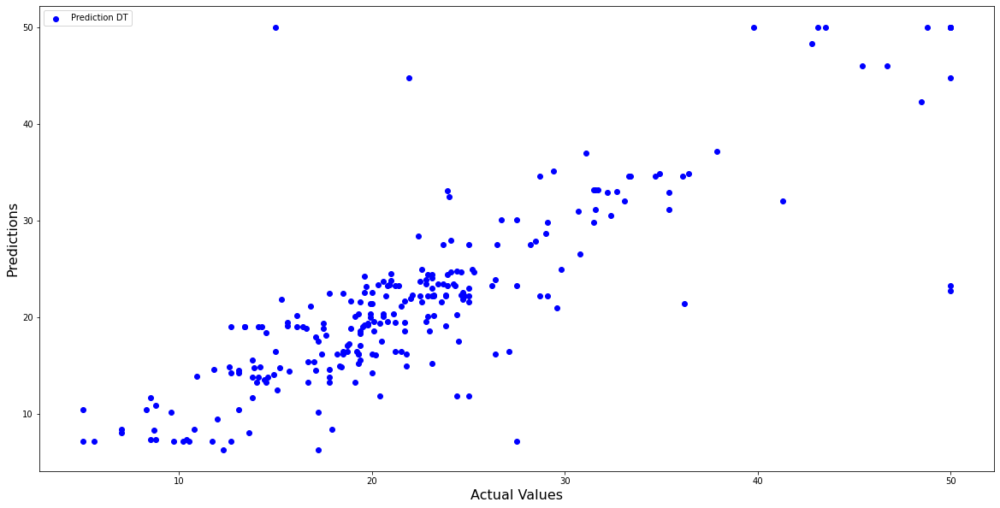

In [22]:
plt.figure(figsize=(20,10))
plt.scatter(y_test,boston_tree.predict(X_test),color='blue',label='Prediction DT')
plt.xlabel("Actual Values", fontsize=16)
plt.ylabel("Predictions", fontsize=16)
plt.legend(loc='upper left');

#### Now we will take a look to the tree itself. This is a bit complex since sklearn does not provide a way to visualize the models. To that end, we will need to make use of an external library: pydotplus.



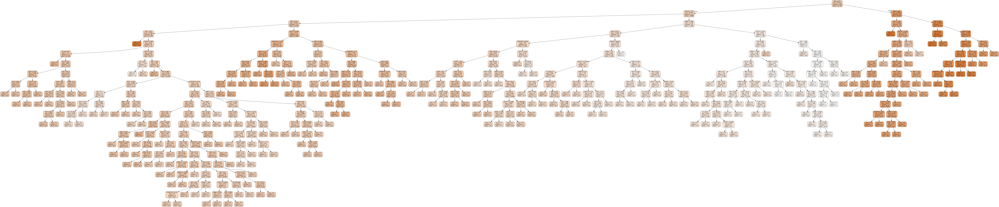

In [23]:
from io import StringIO
from IPython.display import Image  
from sklearn.tree import export_graphviz
import pydotplus

def plot_tree(tree, feature_names):
    dot_data = StringIO()
    export_graphviz(tree, out_file=dot_data, feature_names=feature_names,
                    filled=True, rounded=True,special_characters=True)
    graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
    return Image(graph.create_png())

plot_tree(boston_tree, X_train.columns)

#### Two aspects can be highlighted after taking a look at the tree:

* The tree is huge! As we have not set any complexity pruning or max_depth we have allow the tree to grow without any limit
* RM and LSTAT seem to be the most important features in order to predict the value of the houses. The variable RM measures the number of rooms (i.e., the size of the house). The tree indicates that larger houses correspond to more expensive houses. The LSTAT (the percentage of individuals with lower socioeconomic status) indicates that houses in expensive neighborhoods are more expensive

#### We can confirm this later point by plotting the feature importance

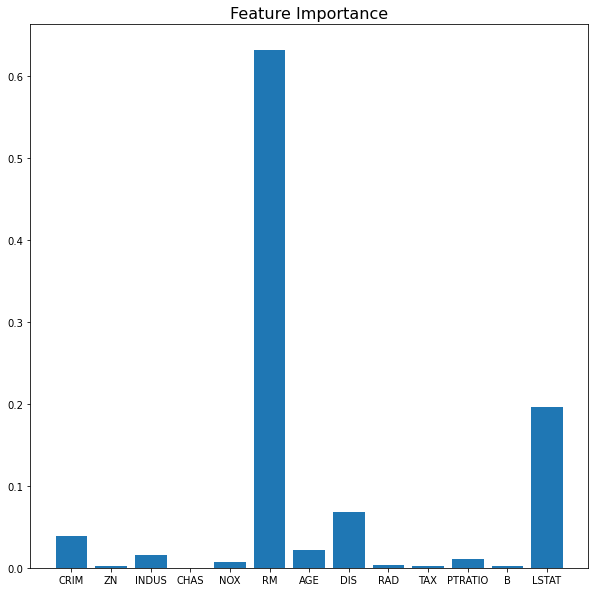

In [24]:
plt.figure(figsize=(10,10))
plt.bar(X_train.columns, boston_tree.feature_importances_)
plt.title('Feature Importance', fontsize=16);


#### Now we will prune the tree to see if we can improve performance.

#### There are different Pruning Parameters:

* max_leaf_nodes: Reduce the number of leaf nodes
* min_samples_leaf: Restrict the size of sample leaf. Minimum sample size in terminal nodes can be fixed to 30, 100, 300 or 5% of total
* max_depth: Reduce the depth of the tree to build a generalized tree. Set the depth of the tree to 3, 5, 10 depending after verification on test data

#### Let's focus on the depth of the tree. We will test different depth thresholds via CV by using the GridSearchCV provided by sklearn.

In [25]:
from sklearn.model_selection import GridSearchCV
param_grid = {'max_depth': range(1,16)}

boston_tree_pruned_cv = GridSearchCV(boston_tree, 
                   param_grid,
                   scoring='neg_mean_squared_error',
                   cv=5 , n_jobs=1, verbose=1)

boston_tree_pruned_cv.fit(X_train,y_train);

Fitting 5 folds for each of 15 candidates, totalling 75 fits


In [26]:
print("Best parameters set found on development set:")
print()
print(boston_tree_pruned_cv.best_params_)
print()
print("Grid scores on development set:")
print()
means = boston_tree_pruned_cv.cv_results_['mean_test_score']
stds = boston_tree_pruned_cv.cv_results_['std_test_score']
for mean, std, params in zip(means, stds, boston_tree_pruned_cv.cv_results_['params']):
    print("MSE = %0.3f (+/%0.03f) for %r" % (-mean, std * 2, params))

Best parameters set found on development set:

{'max_depth': 10}

Grid scores on development set:

MSE = 51.676 (+/16.694) for {'max_depth': 1}
MSE = 29.491 (+/10.384) for {'max_depth': 2}
MSE = 24.546 (+/17.720) for {'max_depth': 3}
MSE = 23.954 (+/20.005) for {'max_depth': 4}
MSE = 23.004 (+/19.699) for {'max_depth': 5}
MSE = 22.983 (+/14.807) for {'max_depth': 6}
MSE = 24.405 (+/22.418) for {'max_depth': 7}
MSE = 26.754 (+/17.717) for {'max_depth': 8}
MSE = 24.181 (+/19.637) for {'max_depth': 9}
MSE = 21.822 (+/12.996) for {'max_depth': 10}
MSE = 26.725 (+/18.362) for {'max_depth': 11}
MSE = 24.308 (+/13.612) for {'max_depth': 12}
MSE = 23.785 (+/23.791) for {'max_depth': 13}
MSE = 24.658 (+/19.529) for {'max_depth': 14}
MSE = 23.492 (+/13.097) for {'max_depth': 15}


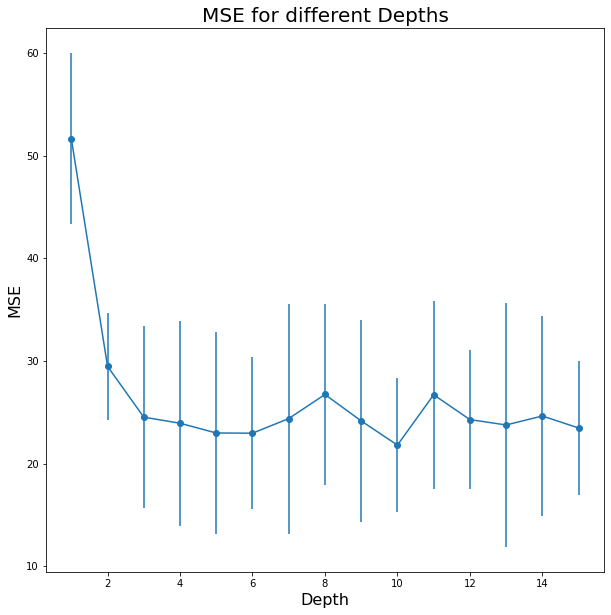

In [27]:
plt.figure(figsize=(10,10))
plt.errorbar(range(1,16,1), [-m for m in means], yerr=stds, fmt='-o')
plt.title('MSE for different Depths', fontsize=20)
plt.xlabel("Depth", fontsize=16)
plt.ylabel("MSE", fontsize=16);

#### As can be seen in the plot, the optimal value for the depth of the decision tree is 9. However, we can find a local optimal at depth 6. Let's prune the tree with this value.



In [28]:
boston_tree_pruned = DecisionTreeRegressor(random_state=42, max_depth=6)
boston_tree_pruned.fit(X_train, y_train)
predictions = boston_tree_pruned.predict(X_test)
print("MSE = {0:.4f}".format(mean_squared_error(y_test, predictions)))

MSE = 25.1772


#### Great! We have reduced the error with a smaller tree. Let's plot it

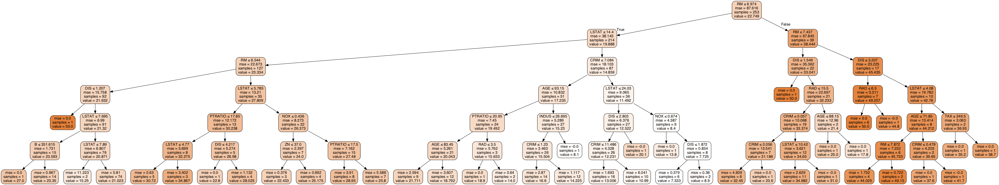

In [29]:
plot_tree(boston_tree_pruned, X_train.columns)

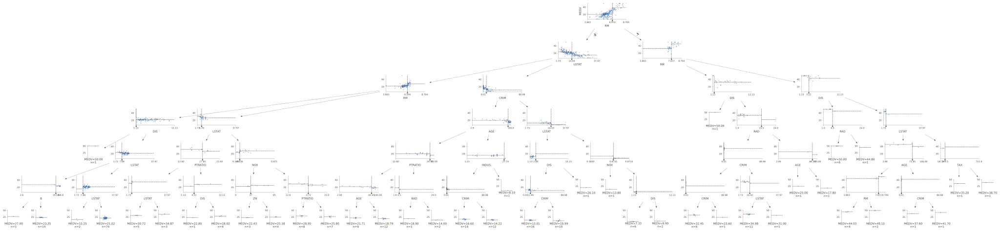

In [31]:
from dtreeviz.trees import *

dtreeviz(boston_tree_pruned, X_train, y_train, target_name='MEDV', feature_names=X_train.columns, 
        fontname='DejaVu Sans', scale=1.5,label_fontsize=10, fancy=True)


# Bagging

#### Here we apply bagging and random forests to the Boston data, using the functions in sklearn. Recall that bagging is simply a special case of a random forest with m = p. Therefore, the RandomForest function can be used to perform both random forests and bagging.



In [ ]:
from sklearn.ensemble import RandomForestRegressor

boston_bagging = RandomForestRegressor(random_state=42, max_features=len(X_train.columns))
boston_bagging.fit(X_train, y_train)
predictions = boston_bagging.predict(X_test)
print("MSE = {0:.4f}".format(mean_squared_error(y_test, predictions)))


#### The test set MSE associated with the bagged regression tree is 14, almost half that obtained using an optimally-pruned single tree.

#### Growing a random forest proceeds in exactly the same way, except that we use a smaller value of the max_features argument. Let's try the $sqrt$ of the number of forest



In [ ]:
boston_rf = RandomForestRegressor(random_state=42, max_features='sqrt')
boston_rf.fit(X_train, y_train)
predictions = boston_rf.predict(X_test)
print("MSE = {0:.4f}".format(mean_squared_error(y_test, predictions)))


#### The performance is even better! As we discussed in class, using less feature allows the process to de-correlate the trees and, consequently, create less overfitted models providing better test performance. Although there is no golden-rule, the $sqrt$ of the number of features is a good starting point.



#### We can take a look to the feature importance in the following plot.



In [ ]:
plt.figure(figsize=(10,10))
plt.bar(X_train.columns, boston_rf.feature_importances_)
plt.title('Feature Importance', fontsize=16);

** As happened in the single models, RM and LSTAT are the most important features by far. However, the model consider in a higher degree the rest of them. In other words, the model overfit less to the individual values of these two features.


** Understanding the importance of our features is very useful for both business and data science point of view.


** From the business point of view you will be able to better motivate and explain your model to the decision makers. This will definitely increase the ratio of acceptance of your models. In addition, your models can be way more useful. If you understand the particular features that drive the prediction of your models, you can actuate over these features or make business decisions based on them. For instance, in this particular example we have seen that the number of rooms plays a significant role in the final price. Therefore, if you have to pick what houses you want to list from the pool of Boston houses, it seems that you should focus on large houses, even if they are old ones (it seems that the AGE feature is not very relevant for the price).


** From a data science point of view, this feature importance is also relevant. If your model is telling you, hey, these are the things I most consider to make my predictions, perhaps you can remove the rest of them. In this sense, the following model implements the same RF configuration but now using just those features that the model told me that are important. As you can see, we are able to create a better model, using still less features.

In [ ]:
boston_rf_small = RandomForestRegressor(random_state=42, max_features='sqrt')
boston_rf_small.fit(X_train[['RM', 'LSTAT','CRIM', 'INDUS', 'NOX', 'DIS', 'TAX', 'PTRATIO']], y_train)
predictions = boston_rf_small.predict(X_test[['RM', 'LSTAT','CRIM', 'INDUS', 'NOX', 'DIS', 'TAX', 'PTRATIO']])
print("MSE = {0:.4f}".format(mean_squared_error(y_test, predictions)))

## Tree Interpretation¶

** A further step in the interpretation of your results is to check how your model behaves for particular examples (i.e., houses in this case). This interpretation is not very useful in the sense of its application to the machine learning process, but it's very important to explain your model in terms of your business problem. Many times you are going to be asked about why your model is offering a giving prediction. While it is quite difficult to analyze the prediction in total, it is pretty simple to understand individual predictions. In addition, project managers can be interested in analyzing individual cases because they know them quite well or because they are important for the business (e.g., premium customers, default or most common instances).

** The idea is the following, you can take an individual house, predict its value, and then inspect how the value of each particular feature of the house has impacted in this prediction.

** To that end, I am going to use the treeinterpreter library

In [ ]:
from treeinterpreter import treeinterpreter as ti

#### Now I am going to take a row (house) from the test dataset.



In [ ]:
row = X_test.values[None,50]
row

#### I now use the predict model in the treeinterpreter library to predict the price for these house. As a result I will get 3 objects:

** The prediction itself

** The bias which includes the average value of the target variable; in this case, the average price of the houses in the dataset.

** The contributions. This object includes a measure about how each features has contributed to the prediction.

** Let's inspect them.

In [ ]:
prediction, bias, contributions = ti.predict(boston_rf, row)


In [ ]:
prediction[0], bias[0]


#### As you can see, the average price of the houses in this dataset is 22.8 while the prediction for the individual house that we are testing is lower 20.54 (i.e., this house is cheaper than the average).

#### By analyzing the contributions we can understand why.



In [ ]:
idxs = np.argsort(contributions[0])
[o for o in zip(X_test.columns[idxs], X_test.iloc[50][idxs], contributions
[0][idxs])]


** We can see that what most is lowering the price of the house is that it only have 6 rooms and that it is in a lower status industrial neighborhood. In contrast, the house is in a place with a good pupil-teacher ratio by town and the neighborhood has a small criminality ratio, which make its price to raise a little bit.

** We can better understand this results with a Waterfall Chart. Waterfall charts are commonly used in business to express cumulative effects of sequential positive or negative values. The following function takes your test data, the number of the row (the specific house) you want to analyze and the RF model you have trained and predicts the value for the given row, analyzes the impact of each feature in the final prediction and plot it as a waterfall chart.



In [ ]:
import plotly.graph_objects as go

def plot_waterfall_chart(X_test, n_row, rf):
    
    row = X_test.values[None,n_row]
    
    prediction, bias, contributions = ti.predict(rf, row)
    
    print("AVG Price = {}\nPredicted Price = {}".format(bias[0], prediction[0][0]))
    
    idxs = np.argsort(contributions[0])

    fig = go.Figure(go.Waterfall(
        name = "20", orientation = "v",
        x = ["AVG Price"] + list(X_test.columns[idxs]),
        textposition = "outside",
        text = [""] + list(X_test.iloc[n_row][idxs]),
        y = [bias[0]]+list(contributions[0][idxs]),
        connector = {"line":{"color":"rgb(63, 63, 63)"}},
    ))

    fig.update_layout(
            title = "Feature Impact on the Final Price",
            showlegend = False
    )

    fig.show()

#### This will plot the waterfall chart for the previous example.

In [ ]:
plot_waterfall_chart(X_test, 50, boston_rf)


** We can compare it to an expensive house...

In [ ]:
plot_waterfall_chart(X_test, 18, boston_rf)

** In this second example the predicted prices is 42, more than double of the previous one. The difference can be analyzed in the waterfall chart. We an see how the fact that it is a very large house (RM) value in a very good neighborhood (LSTAT, INDUS, CRIM) with a good pupil-teacher ratio by town. In contrast, there is nothing actually lowering very much the price of the house. Consequently, the price of the house is very large.



## Exercise #2 (FUNDAMENTAL)
### This problem involves the OJ data set.

1. Load and preview the dataset, to understand what is it about.
2. Create a training set containing a random sample of 800 observations, and a test set containing the remaining observations.
3. Fit a tree to the training data, with Purchase as the response and the other variables as predictors.
4. Create a plot of the tree, and interpret the results.
5. Predict the response on the test data, and produce a confusion matrix comparing the test labels to the predicted test labels. What is the test accuracy?
6. Apply CV to determine the optimal tree size.
7. Produce a plot with tree size on the x-axis and cross-validated classification error rate on the y-axis.
8. Which tree size corresponds to the lowest cross-validated classification error rate?
9. Produce a pruned tree corresponding to the optimal tree size obtained using cross-validation.
10. Compare the accuracy between the pruned and unpruned trees. Which is higher?

#### 0. Load and preview the dataset, to understand what is it about.¶



In [ ]:
import io
import requests

OJ=pd.read_csv("https://raw.githubusercontent.com/jcrouser/islr-python/master/data/OJ.csv", index_col=0)
OJ.head(5)

#### 1. Create a training set containing a random sample of 800 observations, and a test set containing the remaining observations.
#### 2. Fit a tree to the training data, with Purchase as the response and the other variables as predictors.
#### 3. Create a plot of the tree, and interpret the results.
#### 4. Predict the response on the test data, and produce a confusion matrix comparing the test labels to the predicted test labels. What is the test accuracy?
#### 5. Apply CV to determine the optimal tree size.
#### 6. Produce a plot with tree size on the x-axis and cross-validated classification error rate on the y-axis.
#### 7. Which tree size corresponds to the lowest cross-validated classification error rate?
#### 8. Produce a pruned tree corresponding to the optimal tree size obtained using cross-validation.
#### 10. Compare the accuracy between the pruned and unpruned trees. Which is higher?



** By pruning the tree we have improved the test accuracy of the model from .72 to .77

## Exercise #3 (OPTIONAL)

#### Try to solve the Exercise #2 with Boosting trees by playing around with the xgboost(https://xgboost.readthedocs.io/en/latest/python/python_intro.html) library.